# Representation Learning at the Houses of the Oireachtas in Ireland

Notebook dedicated to run representation learning on the Houses of the Oireachtas' data in Ireland.

This work is based on a Senator Representations' work of the US Congress by Nathaniel Tucker:

https://github.com/knathanieltucker/tf-keras-tutorial/blob/master/SenatorRepresentations.ipynb

The Oireachtas is the legislature of the Republic of Ireland.

The Oireachtas consists of:
- The President of Ireland
- The two houses of the Oireachtas:
    - Dáil Éireann (lower house)
    - Seanad Éireann (upper house)
    
Further info: https://en.wikipedia.org/wiki/Oireachtas

Information regarding the Houses of the Oireachtas is featured on their website, including legislation, and is the copyright of the Houses of the Oireachtas: https://beta.oireachtas.ie/. 

Another interesting resource is https://www.kildarestreet.com/ which is a searchable archive of everything that's been said in the Dáil and all written parliamentary questions since January 2004, everything in the Seanad since September 2002, and all Committee meetings since September 2012.

Open Data from the Houses of the Oireachtas can be accessed via:
https://beta.oireachtas.ie/en/open-data/

This includes a link to the open data APIs via a Swagger UI:
https://api.oireachtas.ie/

A vote in the Houses of the Oireachtas is also called a division. We will be looking at this divisions (votings) table for the house and the Seanad (Senate):

In [1]:
import requests # http://docs.python-requests.org/
# http://web.stanford.edu/~zlotnick/TextAsData/Web_Scraping_with_Beautiful_Soup.html
# https://www.crummy.com/software/BeautifulSoup/bs4/doc/
from bs4 import BeautifulSoup
import json
import time
import csv
import numpy as np
from datetime import datetime
import pandas as pd
import re
import os
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
data_path = "data/Ireland/"

In [3]:
def get_votings(chamber = 'seanad', batch = 500, skip = 0):  # chamber: 'seanad' or 'dail' if chamber_type: 'house'
    
    votings_data = []

    table = "divisions" # votings table
    url = 'https://api.oireachtas.ie/v1/{}'.format(table)
    date_start = '1900-01-01'
    date_end = '2100-12-31' # the future
    chamber_type = 'house' # 'committee' or 'house'

    limit = skip + batch
    count = 1 # start

    while count > 0:

        params = dict(chamber_type=chamber_type,
                      chamber=chamber, 
                      date_start=date_start, 
                      date_end=date_end,
                      skip=skip, 
                      limit=limit)
        r = requests.get(url, params=params)

        print r.url

        # print "Headers:", r.headers
        if r.status_code != 200:
            print "Status Code:", r.status_code
            return votings_data

        # Add data from this batch
        contents = r.json()

        if 'message' in contents and contents['message'] == 'server error':
            print 'ERROR RETRIEVING DATA'
            return votings_data

        # Results    
        votings = contents['results'][:batch] # in order not to have duplicates
        votings_data.extend(votings)

        # Update count, more to retrieve?
        count = len(votings)
        print 'Number retrieved', count
        # Update skip and limit for query
        skip += batch
        limit += batch

        time.sleep(1)
        
    return votings_data

### Seanad Éireann (upper house)

In [4]:
# seanad_data = get_votings()

In [5]:
# with open('%s/seanad_data.json' % (data_path), 'w') as outfile:
#      json.dump(seanad_data, outfile)

In [6]:
seanad_data = json.load(open('%s/seanad_data.json' % (data_path)))

How many votings in the Senate?

In [7]:
len(seanad_data)

3838

In [8]:
# seanad_data[0]

### Dáil Éireann (lower house)

In [9]:
# dail_data = get_votings(chamber = 'dail')

In [10]:
# with open('%s/dail_data.json' % (data_path), 'w') as outfile:
#      json.dump(dail_data, outfile)

In [11]:
dail_data = json.load(open('%s/dail_data.json' % (data_path)))

In [12]:
len(dail_data)

8410

In [13]:
# dail_data[0]

Verify there is no duplicates:

In [14]:
def verify_no_voting_duplicates(vote_data):
    votes = []
    duplicates = []
    for vote in vote_data:
        uri = vote["division"]["uri"]
        if uri not in votes:
            # print uri
            votes.append(uri)
        else:
            duplicates.append(uri)
    return len(duplicates)

In [15]:
# verify_no_voting_duplicates(seanad_data)

In [16]:
# verify_no_voting_duplicates(dail_data)

Get members from the votings:

In [17]:
def get_members(vote_data):
    members = set()
    for vote in vote_data:
        div = vote["division"]
        for outcome, voting in div["tallies"].iteritems():            
            if voting is not None:
                # print voting["showAs"] # Tá (YES), Níl (NO), Staon (Abstention)
                # print len(voting["members"])
                for member in voting["members"]:
                    member = member["member"]
                    #last_name, first_name = member["showAs"].split(",")
                    #first_name = first_name[:-1].strip()
                    #last_name = last_name.strip()
                    member_code = member["memberCode"]
                    # print member_code
                    if member_code is not None:
                        members.add(member_code)
    return members

**Senators**

In [18]:
# senators = get_members(seanad_data)

In [19]:
# with open('%s/senators.txt' % (data_path), 'w') as outfile:
#      outfile.write('\n'.join([senator.encode('utf-8') for senator in senators]))

In [20]:
with open('%s/senators.txt' % (data_path)) as infile:
    senators = [senator.strip() for senator in infile.readlines()]

In [21]:
# senators

In [22]:
senators[3]

'Maria-Byrne.S.2016-04-25'

In [23]:
len(senators)

190

In [24]:
print 'Voting members - S:', len([s for s in senators if '.S.' in s]), 'D:', len([s for s in senators if '.D.' in s])

Voting members - S: 149 D: 41


**Deputies**

In [25]:
# deputies = get_members(dail_data)

In [26]:
# with open('%s/deputies.txt' % (data_path), 'w') as outfile:
#      outfile.write('\n'.join([deputy.encode('utf-8') for deputy in deputies]))

In [27]:
with open('%s/deputies.txt' % (data_path)) as infile:
    deputies = [deputy.strip() for deputy in infile.readlines()]

In [28]:
# deputies

In [29]:
deputies[2]

'Martin-Kenny.D.2016-10-03'

In [30]:
len(deputies)

372

In [31]:
print 'Voting members - S:', len([d for d in deputies if '.S.' in d]), 'D:', len([d for d in deputies if '.D.' in d])

Voting members - S: 79 D: 293


All members:

In [32]:
all_members = set(senators).union(deputies)

In [33]:
len(all_members)

478

In [34]:
# all_members

In [35]:
# for v, k in enumerate(set(senators)):
#     print v, k

In [36]:
# leave the first two blank for padding and not a member
senator_to_id = { k: v + 2 for v, k in enumerate(senators) }
deputy_to_id = { k: v + 2 for v, k in enumerate(deputies) }

In [37]:
with open('%s/senator_to_id.txt' % (data_path), 'w') as outfile:
     outfile.write('\n'.join([k + ',' + str(v) for k, v in senator_to_id.items()]))

In [38]:
with open('%s/deputy_to_id.txt' % (data_path), 'w') as outfile:
     outfile.write('\n'.join([k + ',' + str(v) for k, v in deputy_to_id.items()]))

In [39]:
len(senator_to_id), len(deputy_to_id)

(190, 372)

In [40]:
def get_member_id(name, collection):
    name = name.replace(" ", "-").replace(".", "").encode('utf-8')
    sens = [(k, v) for k, v in collection.iteritems() if k is not None and k.startswith(name)]
    if len(sens) == 1:
        return sens[0]
    return '', 1

In [41]:
get_member_id('Aideen Hayden', senator_to_id), get_member_id('Aideen Hayden', deputy_to_id)

(('Aideen-Hayden.S.2011-05-25', 130), ('', 1))

In [42]:
id_to_senator = {v: k for k, v in senator_to_id.items()}
id_to_senator[0] = '<PAD>'
id_to_senator[1] = '<NOT A SENATOR>'

**Parties**

In [43]:
def get_member_party(name):
    uri = 'https://beta.oireachtas.ie/en/members/member/%s/' % (name)
    affiliations = []
    try:
        page = requests.get(uri).text
        # dom = web.Element(page)
        # party = dom.content.split('<p class="bio-text">Party:</p> <p>')[1].split('</p')[0].strip()
        bs = BeautifulSoup(page)
        party = bs.find(text="Party:").findNext('p').contents[0].strip()
    except:
        party = raw_input('For member %s (%s) please input his/her party manually: ' % (name, uri))
    return party

In [44]:
def get_member_affiliations(name):
    uri = 'https://beta.oireachtas.ie/en/members/member/%s/' % (name)
    affiliations = []
    try:
        page = requests.get(uri).text
        bs = BeautifulSoup(page, 'lxml')
        # bs.prettify()
        records = bs.find_all('div', class_='record')
        for r in records:
            membership = r.findNext('h3').contents[0].strip()
            period = r.find_all('p', class_='period')[1].contents[0].strip()
            party = r.find_all('p', class_='party')[1].contents[0].strip()
            constituency = r.find_all('p', class_='constituency')[1].contents[0].strip()
            affiliations.append({
                'membership': membership, 
                'period': period,
                'party': party,
                'constituency': constituency
            })
    except:
        pass
    return affiliations

In [45]:
member = list(senators)[0]

In [46]:
member, get_member_party(member)

/anaconda2/lib/python2.7/site-packages/bs4/__init__.py:181: UserWarning: No parser was explicitly specified, so I'm using the best available HTML parser for this system ("lxml"). This usually isn't a problem, but if you run this code on another system, or in a different virtual environment, it may use a different parser and behave differently.

The code that caused this warning is on line 174 of the file /anaconda2/lib/python2.7/runpy.py. To get rid of this warning, change code that looks like this:

 BeautifulSoup(YOUR_MARKUP})

to this:

 BeautifulSoup(YOUR_MARKUP, "lxml")

  markup_type=markup_type))


('Cecilia-Keaveney.D.1996-04-02', u'Fianna F\xe1il')

In [47]:
get_member_affiliations(member)

[{'constituency': u'Cultural and Educational',
  'membership': u'23rd Seanad',
  'party': u'Fianna F\xe1il',
  'period': u'2007 - 2011'},
 {'constituency': u'Donegal North\u2013East',
  'membership': u'29th D\xe1il',
  'party': u'Fianna F\xe1il',
  'period': u'2002 - 2007'},
 {'constituency': u'Donegal North\u2013East',
  'membership': u'28th D\xe1il',
  'party': u'Fianna F\xe1il',
  'period': u'1997 - 2002'},
 {'constituency': u'Donegal North\u2013East',
  'membership': u'27th D\xe1il',
  'party': u'Fianna F\xe1il',
  'period': u'1996 - 1997'}]

In [48]:
member = list(deputies)[17]
member, get_member_party(member)

('Dessie-Ellis.D.2011-03-09', u'Sinn F\xe9in')

In [49]:
get_member_affiliations(member)

[{'constituency': u'Dublin North-West',
  'membership': u'32nd D\xe1il',
  'party': u'Sinn F\xe9in',
  'period': u'2016 -'},
 {'constituency': u'Dublin North\u2013West',
  'membership': u'31st D\xe1il',
  'party': u'Sinn F\xe9in',
  'period': u'2011 - 2016'}]

In [50]:
# member = list(all_members)[21] # Willie-O'Dea.D.1982-03-09
# print member
# get_member_party(member) # prompt: For member Willie-O'Dea.D.1982-03-09, please input his/her party manually
# Fianna Fáil

In [51]:
def get_parties(members):
    parties = []
    for member in members:
        print 'Member', member
        party = get_member_party(member)
        affiliations = get_member_affiliations(member)
        parties.append(
            {'member': member.strip().decode('utf-8'),
             'party': party,
             'affiliations': affiliations})
    return parties

In [52]:
# parties = get_parties(all_members)

In [53]:
# parties

In [54]:
# with open('%s/parties.json' % (data_path), 'w') as outfile:
#      json.dump(parties, outfile)

In [55]:
parties = json.load(open('%s/parties.json' % (data_path)))

In [56]:
parties[0]

{u'affiliations': [{u'constituency': u'Cultural and Educational',
   u'membership': u'23rd Seanad',
   u'party': u'Fianna F\xe1il',
   u'period': u'2007 - 2011'},
  {u'constituency': u'Donegal North\u2013East',
   u'membership': u'29th D\xe1il',
   u'party': u'Fianna F\xe1il',
   u'period': u'2002 - 2007'},
  {u'constituency': u'Donegal North\u2013East',
   u'membership': u'28th D\xe1il',
   u'party': u'Fianna F\xe1il',
   u'period': u'1997 - 2002'},
  {u'constituency': u'Donegal North\u2013East',
   u'membership': u'27th D\xe1il',
   u'party': u'Fianna F\xe1il',
   u'period': u'1996 - 1997'}],
 u'member': u'Cecilia-Keaveney.D.1996-04-02',
 u'party': u'Fianna F\xe1il'}

In [57]:
member_to_party = { party['member']: party['party'] for party in parties }

In [58]:
# member_to_party

In [59]:
member_to_party[member]

u'Sinn F\xe9in'

In [60]:
member_to_affiliations = { party['member']: [a['membership'] for a in party['affiliations']] for party in parties }

In [61]:
member_to_affiliations[member]

[u'32nd D\xe1il', u'31st D\xe1il']

In [62]:
set(val for val in member_to_party.values())

{u'Ceann Comhairle',
 u'Fianna F\xe1il',
 u'Fine Gael',
 u'Green Party',
 u'Independent',
 u'Independents 4 Change',
 u'Labour',
 u'Labour Party',
 u'Progressive Democrats',
 u'Renua',
 u'Sinn F\xe9in',
 u'Social Democrats',
 u'Socialist Party',
 u'Solidarity - People Before Profit'}

In [63]:
from collections import Counter
Counter([v for v in member_to_party.values()]).most_common()

[(u'Fianna F\xe1il', 165),
 (u'Fine Gael', 122),
 (u'Independent', 64),
 (u'Labour Party', 45),
 (u'Sinn F\xe9in', 33),
 (u'Green Party', 12),
 (u'Labour', 12),
 (u'Progressive Democrats', 9),
 (u'Solidarity - People Before Profit', 6),
 (u'Independents 4 Change', 3),
 (u'Renua', 3),
 (u'Social Democrats', 2),
 (u'Socialist Party', 1),
 (u'Ceann Comhairle', 1)]

In [64]:
def get_party_from_code(code):
    if code is None or code not in member_to_party:
        return None
    return member_to_party[code]

In [65]:
get_party_from_code('Cecilia-Keaveney.D.1996-04-02')

u'Fianna F\xe1il'

**Display names: Name, Party**

In [66]:
# Not all members will appear on the votings 
def get_display_names():
    senator_id_to_displayname = {}
    deputy_id_to_displayname = {}
    for member_code in set(all_members):
        name = member_code.decode('utf-8')
        party = member_to_party[name]
        if name is not None and '.' in name:
            name = " ".join(name.split('.')[0].split('-')) # Complete name
        if party is not None:
            name = name + ", " + party
        # print name
        if member_code in senators:
            senator_id = senator_to_id[member_code]
            senator_id_to_displayname[senator_id] = name
        if member_code in deputies:
            deputy_id = deputy_to_id[member_code]
            deputy_id_to_displayname[deputy_id] = name
    return senator_id_to_displayname, deputy_id_to_displayname

In [67]:
# senator_id_to_displayname, deputy_id_to_displayname = get_display_names()

In [68]:
# with open('%s/senator_id_to_displayname.json' % (data_path), 'w') as outfile:
#      json.dump(senator_id_to_displayname, outfile)

In [69]:
senator_id_to_displayname = {int(k): v for k, v in json.load(open('%s/senator_id_to_displayname.json' % (data_path))).items()}

In [70]:
# senator_id_to_displayname

In [71]:
# with open('%s/deputy_id_to_displayname.json' % (data_path), 'w') as outfile:
#      json.dump(deputy_id_to_displayname, outfile)

In [72]:
deputy_id_to_displayname = {int(k): v for k, v in json.load(open('%s/deputy_id_to_displayname.json' % (data_path))).items()}

In [73]:
len(senator_id_to_displayname), len(deputy_id_to_displayname)

(190, 372)

In [74]:
# senator_id_to_displayname

In [75]:
senator_id_to_displayname[3]

u'D\xe9irdre de B\xfarca, Green Party'

In [76]:
# deputy_id_to_displayname

In [77]:
deputy_id_to_displayname[4]

u'Martin Kenny, Sinn F\xe9in'

**Extracting sponsors and members against a bill**

The following function encapsulates how to extract sponsors and members against a bill based on a line of text manually inputed and in several formats:

In [78]:
# Sponsors and members against a Bill are specified in a text line where we will extract:
# 2 members that sponsored the bill
# 2 members that opposed to the bill
def get_sponsors(tellers_data, collection):
    
    # Remove EM DASH characters
    tellers_data = re.sub(ur'\u2014', '', tellers_data).strip()
    
    sp_first, sp_second, ag_first, ag_second = 1, 1, 1, 1
    sp_f_party, sp_s_party, ag_f_party, ag_s_party = None, None, None, None
    
    if ";" in tellers_data:
        
        tellers = tellers_data.split(";")
        # print tellers
        
        for teller in tellers:
            
            if teller.strip() == "":
                continue
            if "Tellers:" in teller:
                teller = teller.split("Tellers:")[1].strip()
            elif ":" in teller:
                teller = teller.split(":")[1].strip()

            if "," in teller:
                values = teller.split(",")
            elif ":" in teller:
                values = teller.split(":")
            else:
                #print "Bad format"
                continue
            if len(values) != 2:
                #print "BAD format"
                continue
                
            support, members = values

            if "Senators" in members:
                members = members.split("Senators")
                members = members[-1]
            elif "Deputies" in members:
                members = members.split("Deputies")
                members = members[-1]
                
            if " and" in members:
                members = members.split(" and")
            elif "and " in members:
                members = members.split("and ")
            elif "an d":
                members = members.split("an d")
            else:
                members = members.split("and")
            
            if len(members) > 1:
                first_member, second_member = members[:2]
                first_member = first_member.strip()
                second_member = second_member.strip()
            else:
                first_member = members[0]
                first_member = first_member.strip()
                second_member = "None"
            
            support = support.strip()

            if support.startswith('T'):
                sp_f_code, sp_first = get_member_id(first_member, collection)
                sp_s_code, sp_second = get_member_id(second_member, collection)
                sp_f_party = get_party_from_code(sp_f_code)
                sp_s_party = get_party_from_code(sp_s_code)
                # print "Sponsors", first_member, sp_f_party, sp_first, second_member, sp_second, sp_s_party
                
            elif support.startswith('N'):
                ag_f_code, ag_first = get_member_id(first_member, collection)
                ag_s_code, ag_second = get_member_id(second_member, collection)
                ag_f_party = get_party_from_code(ag_f_code)
                ag_s_party = get_party_from_code(ag_s_code)
                # print "Against", first_member, ag_first, ag_f_party, second_member, ag_second, ag_s_party
                
            #else:   
            #    print support
            #    print support.startswith('T')
                
    return [sp_first, sp_second, ag_first, ag_second], [sp_f_party, sp_s_party, ag_f_party, ag_s_party]

**Votings**

In [89]:
def get_vote_data(data, collection_to_ids, display_names):

    votings = []
    num_votings_not_added = 0
    bills_added, bills_not_added = [], []
    bills_added_outcomes = []

    for vote in data:
        
        # Division
        div = vote["division"]
        # vote['voteId']
        date = datetime.strptime(div["date"], '%Y-%m-%d')
        outcome = div["outcome"] # Carried, Lost, _         
        # is_bill = div["isBill"]
        # category = div["category"]
        tellers = div["tellers"]
        
        # Chamber
        # chamber = div["chamber"]
        # chamber["uri"]
        # chamber["showAs"]
        
        # House
        house = div['house']
        # house_uri = house['uri']
        # chamberType = house['chamberType']
        # house['committeeCode']
        # houseCode = house['houseCode']
        house_num = house['houseNo']
        # house_desc = house['showAs']
        
        # Debate
        # debate = div["debate"]
        # debate_desc = debate['showAs']
        # debate_section = debate['debateSection']
        # debate['uri']

        # Bill sponsors
        # Parties
        sponsors, sp_parties = get_sponsors(tellers, collection_to_ids)
        
        # Tallies
        tallies = div["tallies"]
        
        if sponsors == [1, 1, 1, 1]: # Votings that could not be added
            
            bills_not_added.append(date)
            
            # Individual votes not added
            for cvotes in tallies: # taVotes, nilVotes and staonVotes
                if tallies[cvotes] is not None:
                    num_votings_not_added += len(tallies[cvotes]["members"])
            
        else:
            
            # print sponsors
            # print sp_parties
            
            # Sponsors
            sponsor, cosponsor, against, coagainst = sponsors
            
            # Add outcome
            bills_added_outcomes.append({
                'outcome': outcome,
                'house': house_num,
                'sponsor': sp_parties[0]
            })
            
            for cvotes in tallies: 
                
                if tallies[cvotes] is not None:
                
                    # cvotes:
                    # taVotes,
                    # nilVotes,
                    # staonVotes
                    if cvotes == "taVotes":
                        vote_result = 1 # YES
                    elif cvotes == "nilVotes":
                        vote_result = 0 # NO
                    elif cvotes == "staonVotes":
                        vote_result = 2 # Abstention

                    for vote in tallies[cvotes]["members"]:
                        member = vote["member"]
                        code = member["memberCode"]
                        if code is not None:
                            member_id = collection_to_ids[code.encode('utf8')]
                            party = member_to_party[member["memberCode"]]
                            # replace names with utf8 encoding names
                            # display_names[member_id] = " ".join(code.split('.')[0].split('-')) + ", " + party 
                            # Add vote
                            votings.append({
                                'vote': vote_result, # YES, NO, ABSTENTION
                                'member': member_id,
                                'sponsors': [sponsor, cosponsor],
                                'against': [against, coagainst],
                                'house': house_num
                            })

            bills_added.append(date)
            
    return votings, num_votings_not_added, bills_added, bills_not_added, bills_added_outcomes

In [90]:
# Seanad votings

seanad_votes, seanad_num_votings_not_added, seanad_bills_added, seanad_bills_not_added, seanad_outcomes = get_vote_data(
    seanad_data, senator_to_id, senator_id_to_displayname)

In [91]:
with open('%s/seanad_votes.json' % (data_path), 'w') as outfile:
     json.dump(seanad_votes, outfile)

In [92]:
with open('%s/seanad_outcomes.json' % (data_path), 'w') as outfile:
     json.dump(seanad_outcomes, outfile)

Individual votings added vs. not added:

In [93]:
len(seanad_votes), seanad_num_votings_not_added

(77719, 75300)

Bills added vs. bills not added (as we were not able to find any of the sponsors or members against the bill):

In [94]:
len(seanad_bills_added), len(seanad_bills_not_added)

(1873, 1965)

In [95]:
float(len(seanad_bills_added)) / (len(seanad_bills_added) + len(seanad_bills_not_added))

0.4880145909327775

We were able to extract the sponsors, co-sponsors and members against a bill for almost **50% of the bills**. 

That resulted in more **~77K individual votes** for these bills in the Seanad.

In [96]:
# seanad_votes

In [97]:
# A particular voting for a bill
seanad_votes[0]

{'against': [85, 185],
 'house': u'25',
 'member': 98,
 'sponsors': [145, 72],
 'vote': 1}

In [98]:
seanad_bills_added[0]

datetime.datetime(2018, 5, 9, 0, 0)

In [99]:
min(seanad_bills_added), max(seanad_bills_added)

(datetime.datetime(1964, 2, 26, 0, 0), datetime.datetime(2018, 5, 9, 0, 0))

In [100]:
min(seanad_bills_not_added), max(seanad_bills_not_added)

(datetime.datetime(1923, 2, 21, 0, 0), datetime.datetime(2009, 6, 25, 0, 0))

In [101]:
def plot_bills_analysed(a, n):
    
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 4), dpi=100)
    ax0, ax1 = axes.flatten()

    ax0.hist(a, bins='auto', color='b')
    ax0.set_title('Frequency of bills added: %s' % (len(a)))
    
    ax1.hist(n, bins='auto', color='r')
    ax1.set_title('Frequency of bills NOT added: %s' % (len(n)))

    fig.tight_layout()
    plt.show()

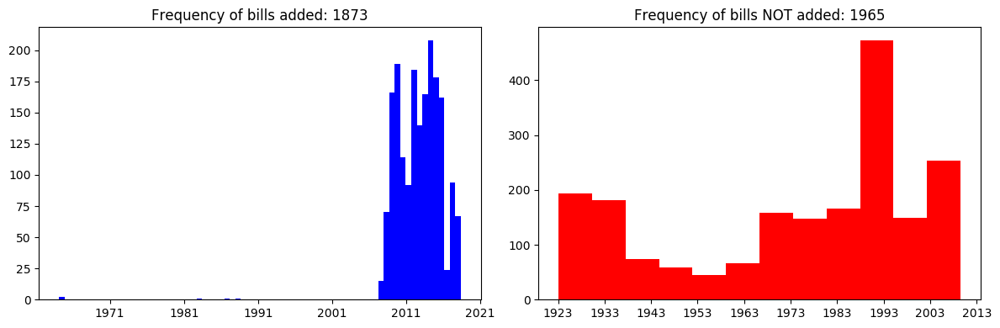

In [102]:
plot_bills_analysed(seanad_bills_added, seanad_bills_not_added)

In [103]:
# Votings gathered from those bills WITH a Sponsor (all of them, if not we disregard it)
Counter([s['member'] == 1 for s in seanad_votes])

Counter({False: 77719})

In [104]:
# Votings gathered from those bills WITH and WITHOUT Co-ponsors
Counter([s['sponsors'][0] == 1 for s in seanad_votes]), Counter([s['sponsors'][1] == 1 for s in seanad_votes])

(Counter({False: 72401, True: 5318}), Counter({False: 67793, True: 9926}))

In [105]:
# Votings gathered from those bills WITH and WITHOUT members Against
Counter([s['against'][0] == 1 for s in seanad_votes]), Counter([s['against'][1] == 1 for s in seanad_votes])

(Counter({False: 72495, True: 5224}), Counter({False: 68765, True: 8954}))

In [106]:
def plot_votings_analysed(v):

    plt.figure(figsize=(12, 4), dpi=100)
    
    values = {}
    values.setdefault(True, [])
    values.setdefault(False, [])
    labels = []
    
    c = Counter([s['member'] == 1 for s in v]).most_common()
    values[True].append(0)
    values[False].append(c[False][1])
    labels.append('Sponsor')
    
    c = Counter([s['sponsors'][0] == 1 for s in v]).most_common()
    values[True].append(c[True][1])
    values[False].append(c[False][1])
    labels.append('Co-sponsor 1')
    c = Counter([s['sponsors'][1] == 1 for s in v]).most_common()
    values[True].append(c[True][1])
    values[False].append(c[False][1])
    labels.append('Co-sponsor 2')
    
    c = Counter([s['against'][0] == 1 for s in v]).most_common()
    values[True].append(c[True][1])
    values[False].append(c[False][1])
    labels.append('Against 1')
    c = Counter([s['against'][1] == 1 for s in v]).most_common()
    values[True].append(c[True][1])
    values[False].append(c[False][1])
    labels.append('Against 2')

    plt.bar(range(1, 6), values[False], width=0.4, color='b', align='center')
    bars = plt.bar(np.arange(1, 6) + 0.4, values[True], width=0.4, color='r', align='center')
    for bar in bars:
        h = bar.get_height()
        if h == 0:
            continue
        plt.text(bar.get_x() + bar.get_width() / 5, h * 1.1, str('{}'.format(h)))
    plt.xticks(range(1, 6), labels)
    
    plt.title('Votings analysed and NOT analysed from the bills extracted')

    plt.show()

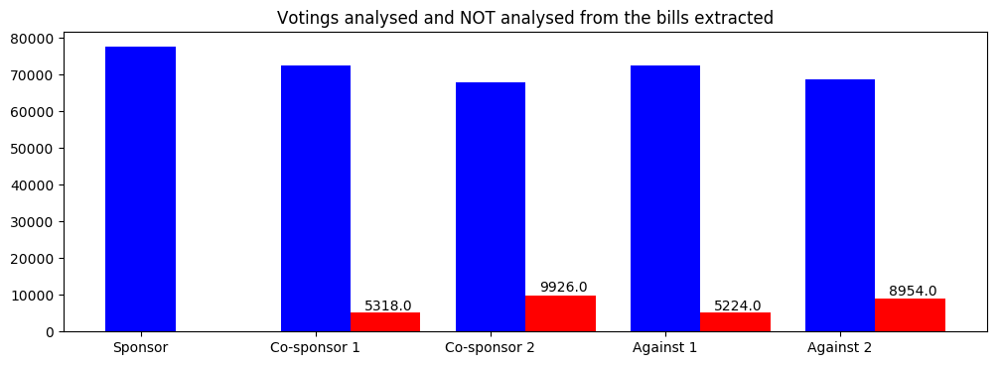

In [107]:
plot_votings_analysed(seanad_votes)

From the bills extracted at the Seanad, most of them contain co-sponsors and members against

In [118]:
# Dail votings

dail_votes, dail_num_votings_not_added, dail_bills_added, dail_bills_not_added, dail_outcomes = \
    get_vote_data(dail_data, deputy_to_id, deputy_id_to_displayname)

In [119]:
with open('%s/dail_votes.json' % (data_path), 'w') as outfile:
     json.dump(dail_votes, outfile)

In [120]:
with open('%s/dail_outcomes.json' % (data_path), 'w') as outfile:
     json.dump(dail_outcomes, outfile)

In [121]:
len(dail_votes), dail_num_votings_not_added

(232294, 677865)

In [122]:
len(dail_bills_added), len(dail_bills_not_added)

(1901, 6509)

In [123]:
# dail_votes

In [124]:
# A particular vote
dail_votes[0]

{'against': [284, 81],
 'house': u'32',
 'member': 56,
 'sponsors': [251, 62],
 'vote': 1}

In [125]:
float(len(dail_bills_added)) / (len(dail_bills_added) + len(dail_bills_not_added))

0.22604042806183117

We were able to extract the sponsors, co-sponsors and members against a bill for **~23% of the bills**. 

That resulted in more **229.5K individual votes** for these bills in the Dail.

In [126]:
min(dail_bills_added), max(dail_bills_added)

(datetime.datetime(1929, 3, 8, 0, 0), datetime.datetime(2018, 5, 10, 0, 0))

In [127]:
min(dail_bills_not_added), max(dail_bills_not_added)

(datetime.datetime(1922, 9, 11, 0, 0), datetime.datetime(2014, 11, 20, 0, 0))

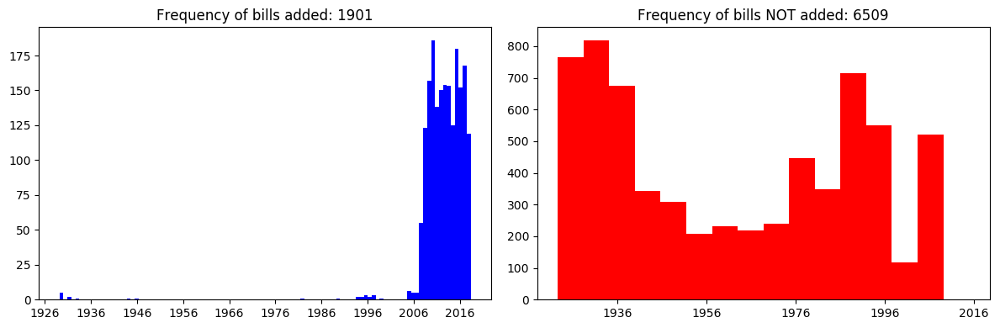

In [128]:
plot_bills_analysed(dail_bills_added, dail_bills_not_added)

In [129]:
Counter([s['member'] == 1 for s in dail_votes])

Counter({False: 232294})

In [130]:
Counter([s['sponsors'][0] == 1 for s in dail_votes]).most_common()

[(False, 228170), (True, 4124)]

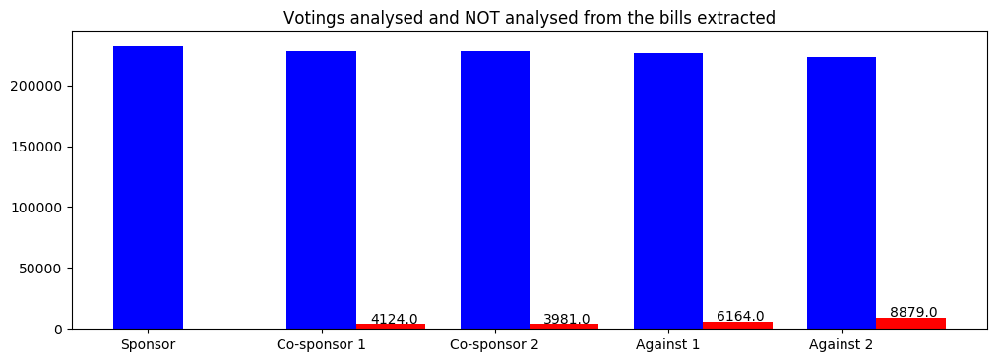

In [131]:
plot_votings_analysed(dail_votes)

Total of individual votes extracted per house:

In [132]:
'Seanad votings {:,}'.format(len(seanad_votes)), 'Dail votings {:,}'.format(len(dail_votes))

('Seanad votings 77,719', 'Dail votings 232,294')

### Senate votings (all data extracted)

In [133]:
# Padding or cropping
# Not needed as all the votes have the same numer of sponsors (2) and against (2)
limit = 2
def pad_or_crop(lst, l=limit):
    return (lst + [0] * l)[:limit]

In [134]:
def get_X_Y(votings):
    
    y = [d['vote'] for d in votings]
    # Show balance
    for k, v in Counter(y).items():
        print 'Class:', k, 'Number: {:,}'.format(v)
    # Reshape
    y = np.array(y).reshape(-1, 1, 1)
    
    x_1 = np.array(map(lambda x: x['member'], votings))
    x_2 = np.array(map(lambda x: pad_or_crop(x['sponsors']), votings))
    x_3 = np.array(map(lambda x: pad_or_crop(x['against']), votings))
    x = [x_1, x_2, x_3]
    
    return x, y

In [135]:
sX, sY = get_X_Y(seanad_votes)

Class: 0 Number: 37,942
Class: 1 Number: 39,777


Classes are very balanced

In [136]:
'{:,}'.format(len(sY))

'77,719'

In [137]:
# we add in padding and unknown senators
senator_id_to_displayname[0] = '<PAD>'
senator_id_to_displayname[1] = '<NOT A SENATOR>'

In [138]:
# senator_id_to_displayname

In [139]:
# this gives us how many representations:
len(senator_id_to_displayname)

192

In [140]:
# we again need to write down the metadata
with open('%s/senator_metadata.csv' % (data_path), 'wb') as csvfile:
    writer = csv.writer(csvfile, delimiter='\t')
    for key, value in sorted(senator_id_to_displayname.items()):
        writer.writerow([value.encode('utf8')])

In [141]:
from keras.layers import concatenate
from keras.layers import Dense, Input, Flatten
from keras.layers import MaxPooling1D, Embedding

from keras.models import Model
from keras.callbacks import TensorBoard

def build_model(X, Y, id_to_displayname, metadata_filename, log_dir, display=0, verbose=2):

    embedding_layer = Embedding(len(id_to_displayname), 100)

    # train a 1D convnet with global maxpooling
    voting = voting_input = Input(shape=(1,), dtype='int32')
    voting = embedding_layer(voting)
    voting = Dense(32, activation='relu')(voting)
    voting = Dense(32, activation='relu')(voting)

    sponsor = sponsor_input = Input(shape=(limit,), dtype='int32')
    sponsor = embedding_layer(sponsor)
    sponsor = MaxPooling1D(limit)(sponsor)
    sponsor = Dense(32, activation='relu')(sponsor)
    sponsor = Dense(32, activation='relu')(sponsor)

    against = against_input = Input(shape=(limit,), dtype='int32')
    against = embedding_layer(against)
    against = MaxPooling1D(limit)(against)
    against = Dense(32, activation='relu')(against)
    against = Dense(32, activation='relu')(against)

    combined = concatenate([voting, sponsor, against])
    combined = Dense(32, activation='relu')(combined)
    combined = Dense(1, activation='sigmoid')(combined)
    
    model = Model([voting_input, sponsor_input, against_input], combined)

    model.compile(loss='binary_crossentropy',
                  optimizer='rmsprop',
                  metrics=['acc'])
    
    if display == 1:
        print(model.summary())

    embedding_metadata = {
        embedding_layer.name: metadata_filename
    }

    model.fit(X, Y,
              batch_size=128,
              epochs=10,
              validation_split=0.2,
              verbose=verbose,
              callbacks=[TensorBoard(log_dir=log_dir, 
                                     embeddings_freq=1,
                                     embeddings_metadata=embedding_metadata)])
    
    return model

Using TensorFlow backend.


In [142]:
seanad_model = build_model(sX, sY, senator_id_to_displayname, 
                           '../senator_metadata.csv', '%s/senator_reps' % (data_path),
                           display=1)

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 1)            0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, 2)            0                                            
__________________________________________________________________________________________________
input_3 (InputLayer)            (None, 2)            0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         multiple             19200       input_1[0][0]                    
                                                                 input_2[0][0]                    
          

In TensorBoard, we can look at the representations created in our model using t-SNE or PCA.

In data/congress/Ireland, launch TensorBoard:
    
> $ tensorboard --logdir=senator_reps/

Go to TensorBoard:

> http://localhost:6006/#projector

Instead, we can also grab the embeddings from the Embeddings' layer, apply PCA and tSNE to customize the visualizations:

In [143]:
# Party names
party_values = sorted(set(member_to_party.values()))
# Colors
# https://matplotlib.org/examples/color/named_colors.html
colors = ['b', 'r', 'b', 'g', 'c', 'm', 'y', 'orange', 
          'chocolate', 'salmon', 'k', 'violet', 'lightblue', 'lightgreen']
assert len(colors) >= len(party_values), "More colors than parties"

# Assign colors to parties for visualizations
party_to_color = {}
party_to_color[''] = 'w' # white for padding
i = 0
for p in party_values:
    party_to_color[p] = colors[i]
    i += 1
party_to_color[u'Anti-Austerity Alliance - People Before Profit'] = 'lightgreen'
party_to_color

{'': 'w',
 u'Anti-Austerity Alliance - People Before Profit': 'lightgreen',
 u'Ceann Comhairle': 'b',
 u'Fianna F\xe1il': 'r',
 u'Fine Gael': 'b',
 u'Green Party': 'g',
 u'Independent': 'c',
 u'Independents 4 Change': 'm',
 u'Labour': 'y',
 u'Labour Party': 'orange',
 u'Progressive Democrats': 'chocolate',
 u'Renua': 'salmon',
 u'Sinn F\xe9in': 'k',
 u'Social Democrats': 'violet',
 u'Socialist Party': 'lightblue',
 u'Solidarity - People Before Profit': 'lightgreen'}

In [144]:
def plot_dimensionality_reduction(ax, low_dim_embs, labels, filename='image.png', parties=[], tags=None):
    assert low_dim_embs.shape[0] >= len(labels), "More labels than embeddings"
    for i, label in enumerate(labels):
        # Party
        party = ''
        if ',' in label:
            party = label.split(',')[1].strip()
        if party not in party_to_color:
            print 'Party "%s" could not be not found' % (party)
            continue
        # Color
        if len(parties) == 0 or party in parties:
            color = party_to_color[party]
        else:
            color = 'gray'
        # Plot
        x, y = low_dim_embs[i, :]
        ax.scatter(x, y, color=color) #, label=party)
        if tags is not None:
            ax.annotate(label,
                         xy=(x, y),
                         xytext=(5, 2),
                         textcoords='offset points',
                         ha='right',
                         va='bottom')
    # ax.legend()

Functions to get embeddings, apply PCA and apply tSNE:

In [145]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

def get_embeddings(model, id_to_displayname):

    # Embedding Layer
    embedding_layer = model.layers[3]
    embeddings = embedding_layer.get_weights()[0]
    print 'Embedding Layer shape:', embeddings.shape

    # Labels
    labels = id_to_displayname.values()
    
    return embeddings, labels

def get_pca(embeddings):

    # PCA
    pca = PCA(n_components=2)
    principal_components = pca.fit_transform(embeddings)
    print 'PCA explained variance ratio:', pca.explained_variance_ratio_, 'Total:', sum(pca.explained_variance_ratio_)
    return principal_components
    
def get_tsne(embeddings):
    
    # tSNE
    tsne = TSNE(perplexity=30, n_components=2, init='pca', n_iter=5000)
    low_dim_embs = tsne.fit_transform(embeddings)
    return low_dim_embs

Get embeddings:

In [146]:
seanad_embeddings, seanad_labels = get_embeddings(seanad_model, senator_id_to_displayname)

Embedding Layer shape: (192, 100)


Get principal components from **PCA**:

In [147]:
seanad_pc = get_pca(seanad_embeddings)

PCA explained variance ratio: [ 0.50455672  0.13327181] Total: 0.637828528881


Plot parties for a lower dimensionality technique (PCA or tSNE):

In [148]:
def plot_parties(lower_dim, labels, name):
    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(10, 10), dpi=1000)
    ax0, ax1, ax2, ax3, ax4, ax5 = axes.flatten()
    # Plot ax0
    plot_dimensionality_reduction(ax0, lower_dim, labels, parties=[u'Fianna F\xe1il'])
    ax0.set_title('Fianna Fail')
    # Plot ax1
    plot_dimensionality_reduction(ax1, lower_dim, labels, parties=[u'Sinn F\xe9in'])
    ax1.set_title('Sinn Fein')
    # Plot ax2
    plot_dimensionality_reduction(ax2, lower_dim, labels, parties=['Fine Gael'])
    ax2.set_title('Fine Gael')
    # Plot ax3
    plot_dimensionality_reduction(ax3, lower_dim, labels, parties=['Independent', 'Independents 4 Change'])
    ax3.set_title('Independents')
    # Plot ax4
    plot_dimensionality_reduction(ax4, lower_dim, labels, parties=['Labour', 'Labour Party'])
    ax4.set_title('Labour')
    # Plot ax5
    plot_dimensionality_reduction(ax5, lower_dim, labels, 
                                  parties=['Ceann Comhairle', 'Green Party', 'Progressive Democrats', 
                                           'Renua', 'Social Democrats', 'Socialist Party', 
                                           'Solidarity - People Before Profit',])
    ax5.set_title('Rest of the parties')
    fig.tight_layout()
    plt.savefig(os.path.join('figures', name))

In [149]:
plot_parties(seanad_pc, seanad_labels, 'seanad_pca_parties_all_houses.png')

In [150]:
def plot_all(pc, labels, name, tags=None):
    plt.figure(figsize=(18, 18), dpi=100)
    plot_dimensionality_reduction(plt, pc, labels, parties=[], tags=tags)
    plt.savefig(os.path.join('figures', name))

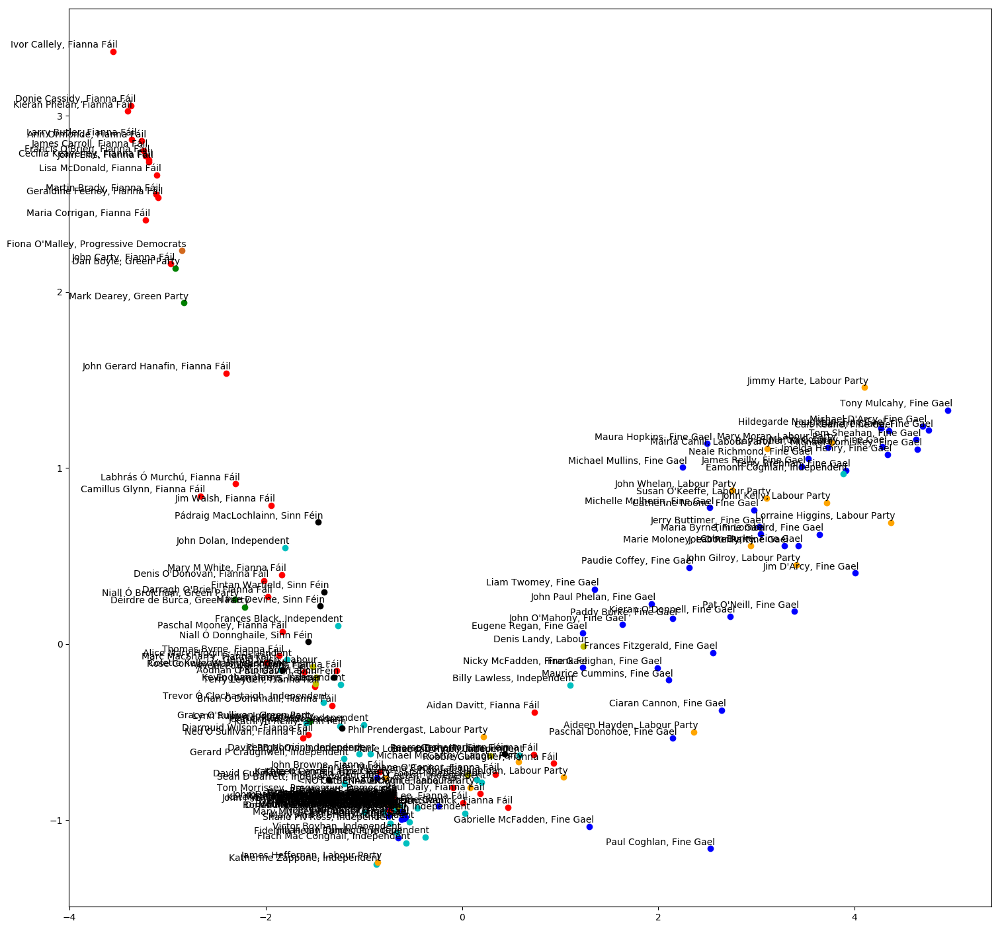

In [151]:
plot_all(seanad_pc, seanad_labels, 'seanad_pca_all_houses_tags', tags=1)

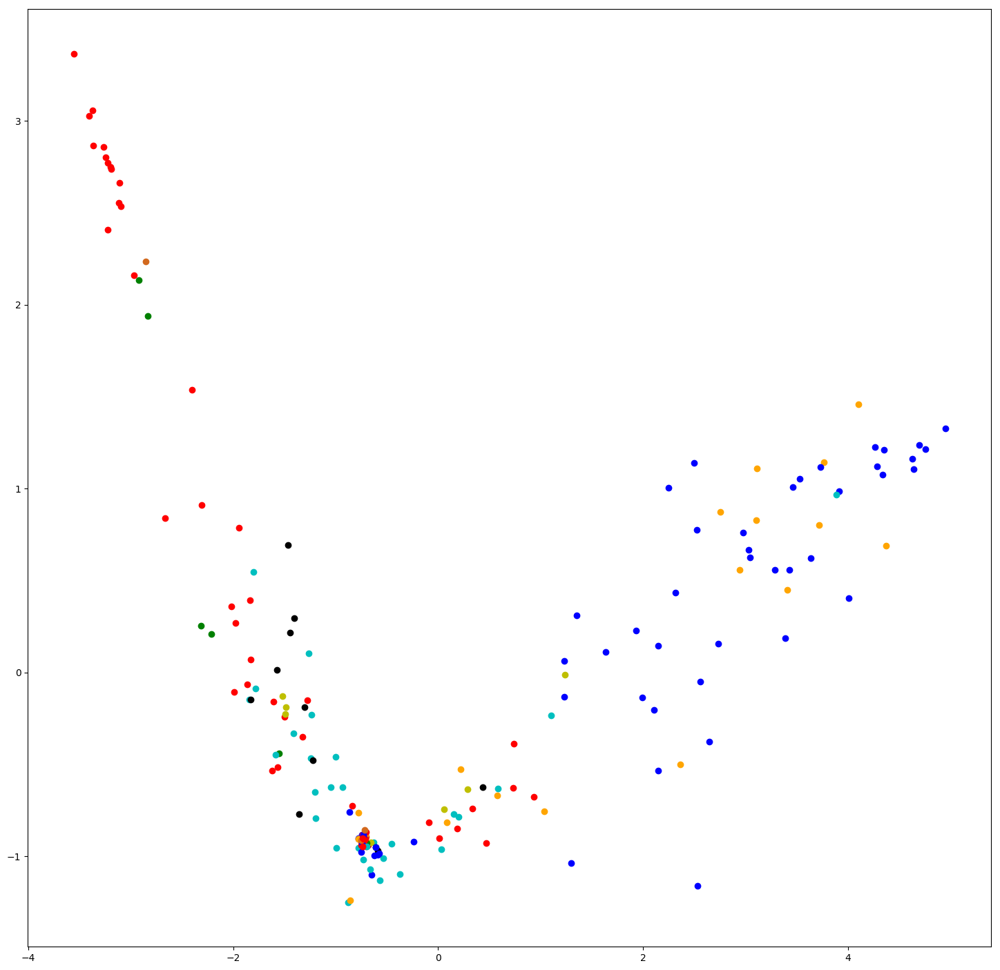

In [152]:
plot_all(seanad_pc, seanad_labels, 'seanad_pca_all_houses')

Get a lower dimensional representation using the non-deterministic clustering technique **tSNE**:

In [153]:
seanad_tsne = get_tsne(seanad_embeddings)

In [154]:
plot_parties(seanad_tsne, seanad_labels, 'seanad_tsne_parties_all_houses.png')

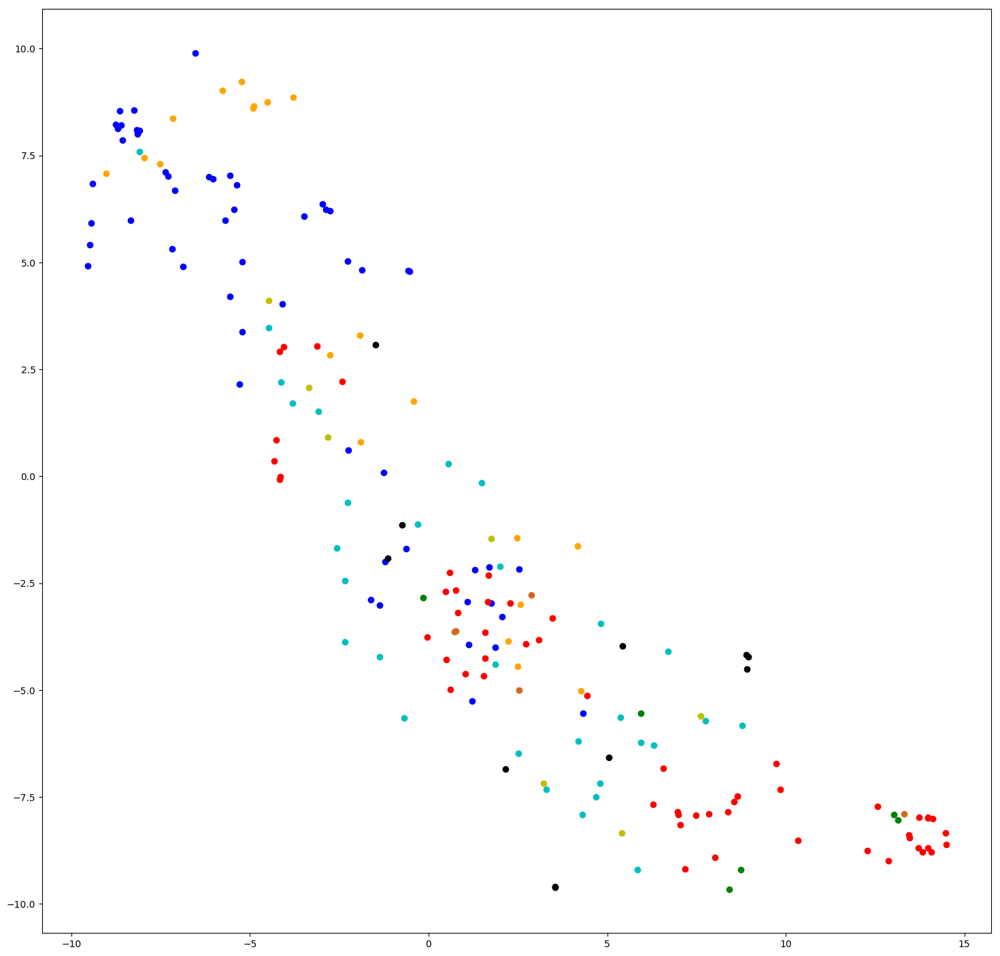

In [155]:
plot_all(seanad_tsne, seanad_labels, 'seanad_tsne_all_houses')

### Dail votings (all data extracted)

In [156]:
dX, dY = get_X_Y(dail_votes)

Class: 0 Number: 103,658
Class: 1 Number: 125,842
Class: 2 Number: 2,794


In [157]:
'{:,}'.format(len(dY))

'232,294'

In [158]:
# we add in padding and unknown senators
deputy_id_to_displayname[0] = '<PAD>'
deputy_id_to_displayname[1] = '<NOT A DEPUTY>'

In [159]:
# deputy_id_to_displayname

In [160]:
len(deputy_id_to_displayname)

374

In [161]:
# we again need to write down the metadata
with open('%s/deputy_metadata.csv' % (data_path), 'wb') as csvfile:
    writer = csv.writer(csvfile, delimiter='\t')
    for key, value in sorted(deputy_id_to_displayname.items()):
        writer.writerow([value.encode('utf8')])

In [162]:
dail_model = build_model(dX, dY, deputy_id_to_displayname, '../deputy_metadata.csv', '%s/deputy_reps' % (data_path))

Train on 185835 samples, validate on 46459 samples
Epoch 1/10
 - 9s - loss: 0.1229 - acc: 0.9019 - val_loss: 0.1534 - val_acc: 0.9637
Epoch 2/10
 - 8s - loss: -3.0998e-02 - acc: 0.9381 - val_loss: 0.1952 - val_acc: 0.9582
Epoch 3/10
 - 9s - loss: -5.3723e-02 - acc: 0.9423 - val_loss: 0.2298 - val_acc: 0.9446
Epoch 4/10
 - 8s - loss: -6.5719e-02 - acc: 0.9455 - val_loss: 0.3099 - val_acc: 0.9190
Epoch 5/10
 - 9s - loss: -7.3164e-02 - acc: 0.9471 - val_loss: 0.3203 - val_acc: 0.9120
Epoch 6/10
 - 8s - loss: -7.8668e-02 - acc: 0.9487 - val_loss: 0.3847 - val_acc: 0.9006
Epoch 7/10
 - 8s - loss: -8.1680e-02 - acc: 0.9497 - val_loss: 0.3735 - val_acc: 0.9153
Epoch 8/10
 - 9s - loss: -8.6158e-02 - acc: 0.9499 - val_loss: 0.4363 - val_acc: 0.8648
Epoch 9/10
 - 8s - loss: -8.9657e-02 - acc: 0.9510 - val_loss: 0.5040 - val_acc: 0.8676
Epoch 10/10
 - 9s - loss: -9.2586e-02 - acc: 0.9521 - val_loss: 0.5378 - val_acc: 0.8427


In data/congress/Ireland, launch TensorBoard:
    
> $ tensorboard --logdir=deputy_reps/ --port=6007

Go to TensorBoard:

> http://localhost:6007/#projector

**Embeddings**, **PCA** and **tSNE**:

In [163]:
dail_embeddings, dail_labels = get_embeddings(dail_model, deputy_id_to_displayname)

Embedding Layer shape: (374, 100)


In [164]:
dail_pc = get_pca(dail_embeddings)

PCA explained variance ratio: [ 0.54355448  0.12122607] Total: 0.664780557156


In [165]:
plot_parties(dail_pc, dail_labels, 'dail_pca_parties_all_houses.png')

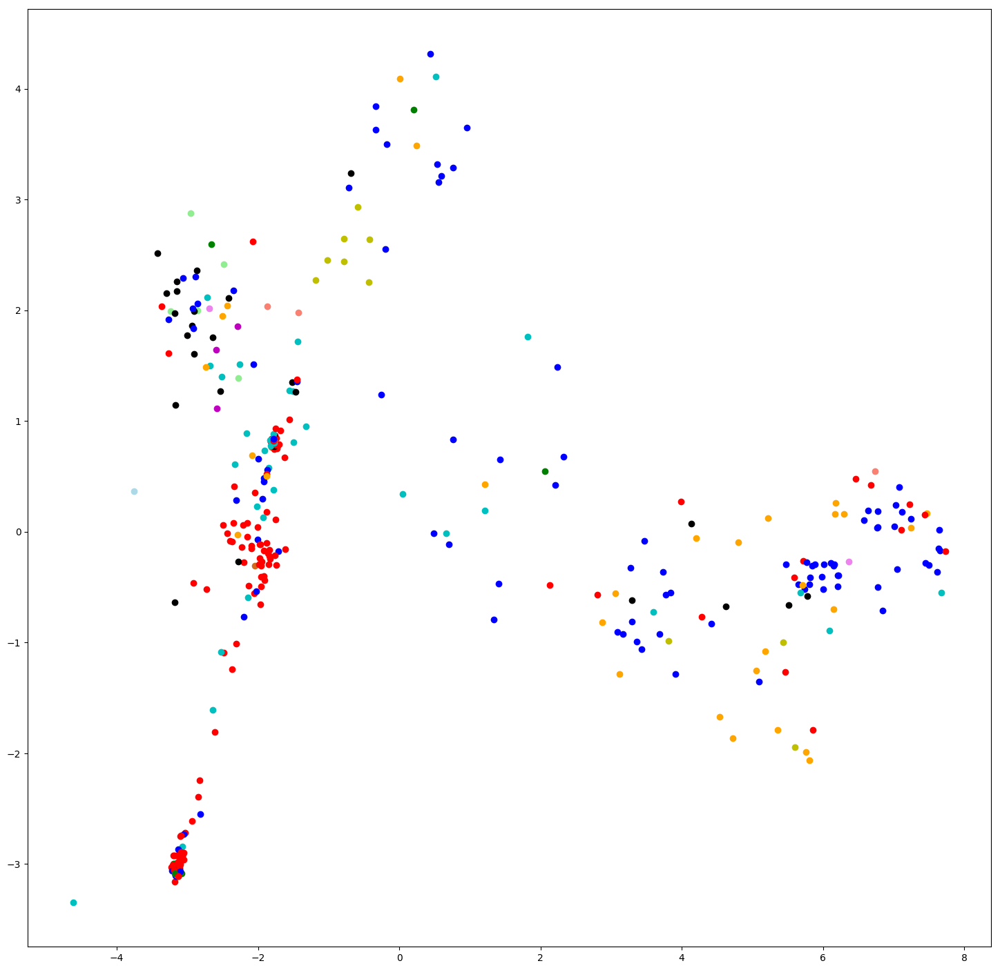

In [166]:
plot_all(dail_pc, dail_labels, 'dail_pca_all_houses.png')

In [167]:
dail_tsne = get_tsne(dail_embeddings)

In [168]:
plot_parties(dail_tsne, dail_labels, 'dail_tsne_parties_all_houses.png')

**Future work:** 

- Neighbors: compute the top N closest neighbors for each member
- Centroids: compute the centroid for each party, apply PCA and visualize which parties are closer to each other

### Seanad votings (per house)

In [169]:
df_seanad_votes = pd.DataFrame(seanad_votes)
df_seanad_votes.head(2)

,against,house,member,sponsors,vote
0,"[85, 185]",25,98,"[145, 72]",1
1,"[85, 185]",25,160,"[145, 72]",1


In [170]:
print 'House - Count\n', df_seanad_votes['house'].value_counts()

House - Count
24    43845
23    27120
25     6754
Name: house, dtype: int64


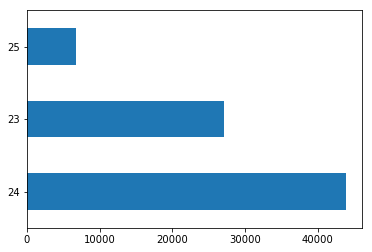

In [171]:
df_seanad_votes['house'].value_counts().plot(kind="barh")

In [172]:
seanad_houses = sorted(df_seanad_votes.house.unique())
seanad_houses

[u'23', u'24', u'25']

#### Seanad House 23

Plot outcomes for a house:

In [173]:
def plot_outcome_per_party(outcomes, house, colors):
    
    df = pd.DataFrame(outcomes)
    
    grouped = df[df['house'] == house].groupby(['sponsor', 'outcome']).size()
    
    unstacked = grouped.unstack()
    
    print unstacked
    
    unstacked.plot.bar(
        stacked=False, color=colors, figsize=(16, 4), grid=False)
    ax = plt.axes()
    # x_axis = ax.axes.get_xaxis()
    # x_axis.set_ticklabels([])
    plt.title('House %s - Votings outcomes per party based on the first sponsor' % (house))
    plt.ylabel('# Votings')
    plt.xlabel('Parties')
    plt.show()

outcome       Carried   Lost     _
sponsor                           
Fianna Fáil     123.0    1.0   2.0
Fine Gael         NaN  197.0  14.0
Green Party       3.0    NaN   NaN
Independent       NaN    1.0   NaN
Labour            NaN   27.0   2.0
Labour Party      NaN   20.0   2.0
Sinn Féin         NaN    3.0   1.0


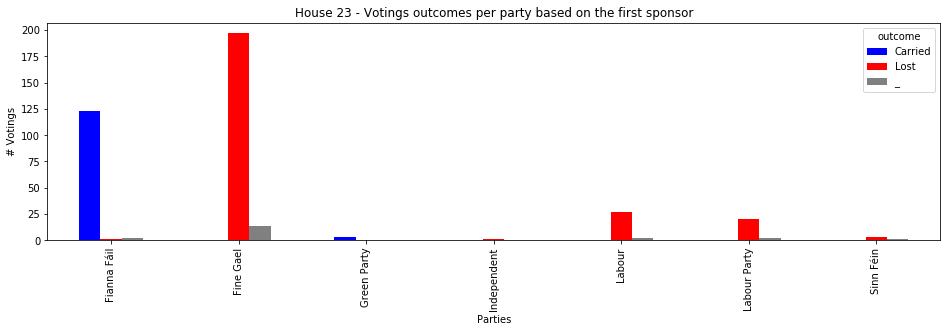

In [174]:
plot_outcome_per_party(seanad_outcomes, house='23', colors=['b', 'r', 'grey'])

In [175]:
def analyse_house(df, house_number, prefix='senator', id_to_displayname=senator_id_to_displayname):
    
    # DataFrame
    dataframe = df[df['house'] == house_number]
    print 'Number votings: {:,}'.format(dataframe.shape[0])
    
    # Members
    voting_members = dataframe.member.unique()
    sponsors = set()
    for item in list(dataframe['sponsors']):
        first, second = item
        sponsors.add(first)
        sponsors.add(second)
    for item in list(dataframe['against']):
        first, second = item
        sponsors.add(first)
        sponsors.add(second)
    house_members = sorted(sponsors.union(voting_members))
    print 'House members:', len(house_members)
    
    # IDs
    d = { house_members[n]: n for n in range(len(house_members)) }
    
    # Votes
    house_votes = []
    for index, row in dataframe.iterrows():
        house_votes.append({
            'vote': row['vote'],
            'member': d[row['member']],
            'sponsors': [d[row['sponsors'][0]], d[row['sponsors'][1]]],
            'against': [d[row['against'][0]], d[row['against'][1]]]
        })
    
    # X, Y
    print 'Votes:'
    hX, hY = get_X_Y(house_votes)
    
    # Displaynames
    house_displaynames = { m: id_to_displayname[m] for m in house_members }
    
    # Metadata
    with open('%s/%s_%s_metadata.csv' % (data_path, prefix, house_number), 'wb') as csvfile:
        writer = csv.writer(csvfile, delimiter='\t')
        for k, v in house_displaynames.items():
            writer.writerow([v.encode('utf8')])
    
    # Model
    house_model = build_model(hX, hY, house_displaynames, '../%s_%s_metadata.csv' % (prefix, house_number), 
                              '%s/%s_%s_reps' % (data_path, prefix, house_number),
                              verbose=1)
    
    # Embeddings
    house_embeddings, house_labels = get_embeddings(house_model, house_displaynames)
    
    # PCA
    print 'PCA'
    house_pc = get_pca(house_embeddings)
    plot_parties(house_pc, house_labels, '%s_pca_parties_house_%s.png' % (prefix, house_number))
    
    # tSNE
    print 'tSNE'
    house_tsne = get_tsne(house_embeddings)
    plot_parties(house_tsne, house_labels, '%s_tsne_parties_house_%s.png' % (prefix, house_number))

In [176]:
analyse_house(df_seanad_votes, '23')

Number votings: 27,120
House members: 65
Votes:
Class: 0 Number: 13,217
Class: 1 Number: 13,903
Train on 21696 samples, validate on 5424 samples
Epoch 1/10
21696/21696 [==============================] - 7s 329us/step - loss: 0.2386 - acc: 0.8929 - val_loss: 0.1480 - val_acc: 0.9631
Epoch 2/10
21696/21696 [==============================] - 7s 340us/step - loss: 0.0806 - acc: 0.9721 - val_loss: 0.1566 - val_acc: 0.9633
Epoch 3/10
21696/21696 [==============================] - 6s 295us/step - loss: 0.0765 - acc: 0.9732 - val_loss: 0.1627 - val_acc: 0.9528
Epoch 4/10
21696/21696 [==============================] - 7s 307us/step - loss: 0.0749 - acc: 0.9723 - val_loss: 0.1775 - val_acc: 0.9489
Epoch 5/10
21696/21696 [==============================] - 5s 247us/step - loss: 0.0737 - acc: 0.9730 - val_loss: 0.1878 - val_acc: 0.9519
Epoch 6/10
21696/21696 [==============================] - 6s 269us/step - loss: 0.0722 - acc: 0.9732 - val_loss: 0.2009 - val_acc: 0.9502
Epoch 7/10
21696/21696 [===

#### Seanad House 24

outcome       Carried   Lost    _
sponsor                          
Fianna Fáil       8.0  262.0  NaN
Fine Gael       431.0   14.0  2.0
Independent       5.0   91.0  NaN
Labour           63.0    1.0  NaN
Labour Party     26.0    3.0  NaN
Sinn Féin         NaN   57.0  1.0


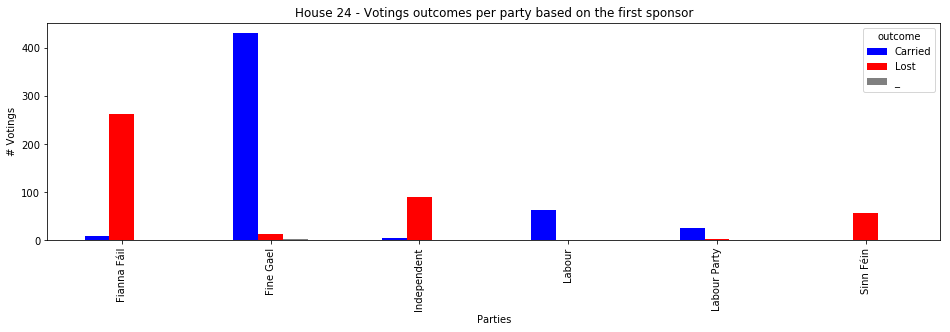

In [177]:
plot_outcome_per_party(seanad_outcomes, house='24', colors=['b', 'r', 'grey'])

In [178]:
analyse_house(df_seanad_votes, '24')

Number votings: 43,845
House members: 77
Votes:
Class: 0 Number: 21,415
Class: 1 Number: 22,430
Train on 35076 samples, validate on 8769 samples
Epoch 1/10
35076/35076 [==============================] - 12s 328us/step - loss: 0.2312 - acc: 0.8962 - val_loss: 0.1917 - val_acc: 0.9147
Epoch 2/10
35076/35076 [==============================] - 10s 278us/step - loss: 0.1348 - acc: 0.9448 - val_loss: 0.1561 - val_acc: 0.9368
Epoch 3/10
35076/35076 [==============================] - 15s 413us/step - loss: 0.1291 - acc: 0.9471 - val_loss: 0.1311 - val_acc: 0.9580
Epoch 4/10
35076/35076 [==============================] - 11s 328us/step - loss: 0.1255 - acc: 0.9487 - val_loss: 0.1618 - val_acc: 0.9264
Epoch 5/10
35076/35076 [==============================] - 23s 646us/step - loss: 0.1231 - acc: 0.9497 - val_loss: 0.1390 - val_acc: 0.9431
Epoch 6/10
35076/35076 [==============================] - 19s 543us/step - loss: 0.1211 - acc: 0.9499 - val_loss: 0.1442 - val_acc: 0.9486
Epoch 7/10
35076/3507

#### Seanad House 25

outcome      Carried  Lost
sponsor                   
Fianna Fáil     12.0   5.0
Fine Gael       60.0   4.0
Green Party      NaN   2.0
Independent     15.0  29.0
Labour           2.0   4.0
Sinn Féin        1.0  27.0


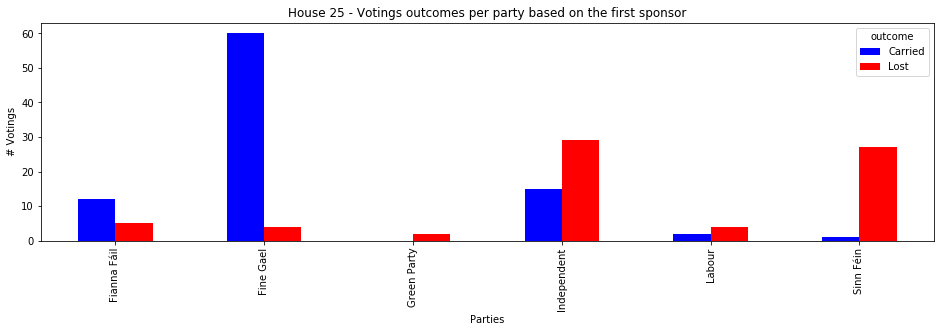

In [179]:
plot_outcome_per_party(seanad_outcomes, house='25', colors=['b', 'r', 'grey'])

In [180]:
analyse_house(df_seanad_votes, '25')

Number votings: 6,754
House members: 61
Votes:
Class: 0 Number: 3,310
Class: 1 Number: 3,444
Train on 5403 samples, validate on 1351 samples
Epoch 1/10
5403/5403 [==============================] - 19s 3ms/step - loss: 0.6084 - acc: 0.6800 - val_loss: 0.5005 - val_acc: 0.7816
Epoch 2/10
5403/5403 [==============================] - 20s 4ms/step - loss: 0.3344 - acc: 0.8469 - val_loss: 0.3183 - val_acc: 0.8868
Epoch 3/10
5403/5403 [==============================] - 16s 3ms/step - loss: 0.2244 - acc: 0.9088 - val_loss: 0.2687 - val_acc: 0.9038
Epoch 4/10
5403/5403 [==============================] - 15s 3ms/step - loss: 0.1963 - acc: 0.9215 - val_loss: 0.2434 - val_acc: 0.8905
Epoch 5/10
5403/5403 [==============================] - 15s 3ms/step - loss: 0.1801 - acc: 0.9273 - val_loss: 0.2581 - val_acc: 0.8949
Epoch 6/10
5403/5403 [==============================] - 15s 3ms/step - loss: 0.1681 - acc: 0.9328 - val_loss: 0.2652 - val_acc: 0.8816
Epoch 7/10
5403/5403 [===========================

### Dail votings (per house)

In [181]:
df_dail_votes = pd.DataFrame(dail_votes)
df_dail_votes.head(2)

,against,house,member,sponsors,vote
0,"[284, 81]",32,56,"[251, 62]",1
1,"[284, 81]",32,154,"[251, 62]",1


In [182]:
print 'House - Count\n', df_dail_votes['house'].value_counts()

House - Count
31    104826
30     82824
32     42915
29      1729
Name: house, dtype: int64


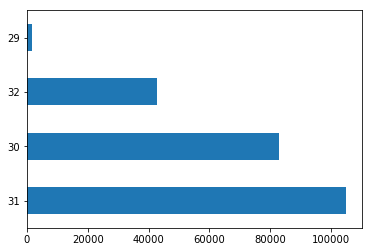

In [183]:
df_dail_votes['house'].value_counts().plot(kind="barh")

In [184]:
dail_houses = sorted(df_dail_votes.house.unique())
dail_houses

[u'29', u'30', u'31', u'32']

#### Dail House 29

outcome      _
sponsor       
Fine Gael  1.0


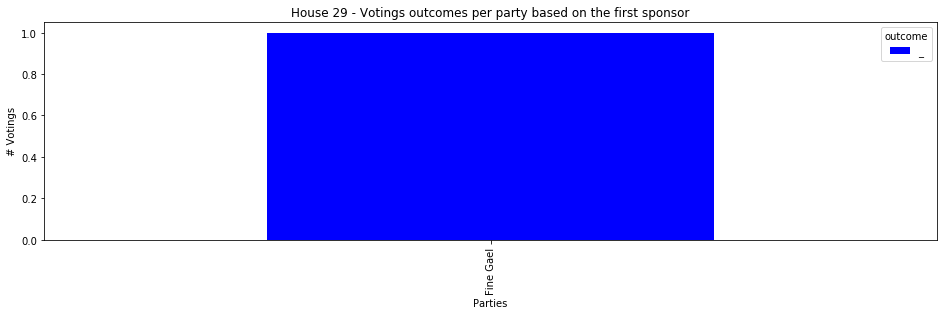

In [191]:
plot_outcome_per_party(dail_outcomes, house='29', colors=['b', 'r', 'grey'])

In [192]:
analyse_house(df_dail_votes, '29', prefix='deputy', id_to_displayname=deputy_id_to_displayname)

Number votings: 1,729
House members: 164
Votes:
Class: 0 Number: 716
Class: 1 Number: 1,013
Train on 1383 samples, validate on 346 samples
Epoch 1/10
1383/1383 [==============================] - 14s 10ms/step - loss: 0.6621 - acc: 0.5879 - val_loss: 0.6825 - val_acc: 0.6098
Epoch 2/10
1383/1383 [==============================] - 15s 11ms/step - loss: 0.6322 - acc: 0.6544 - val_loss: 0.6767 - val_acc: 0.6098
Epoch 3/10
1383/1383 [==============================] - 14s 10ms/step - loss: 0.5913 - acc: 0.6457 - val_loss: 0.7164 - val_acc: 0.6098
Epoch 4/10
1383/1383 [==============================] - 14s 10ms/step - loss: 0.5160 - acc: 0.7339 - val_loss: 0.6779 - val_acc: 0.6098
Epoch 5/10
1383/1383 [==============================] - 14s 10ms/step - loss: 0.4057 - acc: 0.8879 - val_loss: 0.6202 - val_acc: 0.6098
Epoch 6/10
1383/1383 [==============================] - 15s 11ms/step - loss: 0.2884 - acc: 0.9725 - val_loss: 0.6554 - val_acc: 0.6098
Epoch 7/10
1383/1383 [=======================

#### Dail House 30

outcome       Carried  Lost     _
sponsor                          
Fianna Fáil     501.0   3.0  20.0
Fine Gael         NaN  26.0   3.0
Labour Party      1.0  30.0   7.0


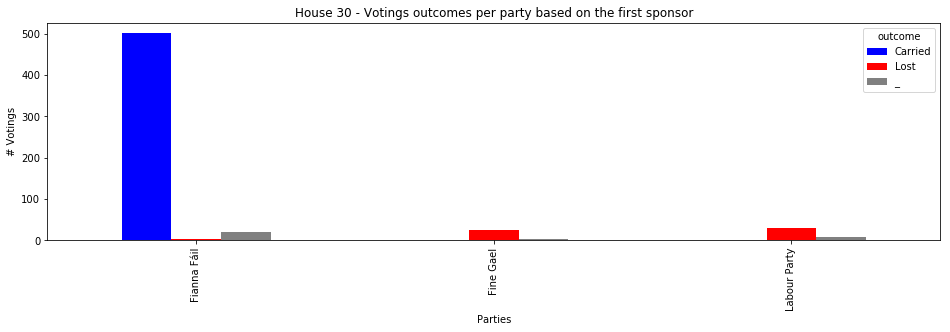

In [185]:
plot_outcome_per_party(dail_outcomes, house='30', colors=['b', 'r', 'grey'])

In [186]:
analyse_house(df_dail_votes, '30', prefix='deputy', id_to_displayname=deputy_id_to_displayname)

Number votings: 82,824
House members: 169
Votes:
Class: 0 Number: 38,975
Class: 1 Number: 43,849
Train on 66259 samples, validate on 16565 samples
Epoch 1/10
66259/66259 [==============================] - 28s 418us/step - loss: 0.0789 - acc: 0.9710 - val_loss: 0.1138 - val_acc: 0.9769
Epoch 2/10
66259/66259 [==============================] - 27s 408us/step - loss: 0.0244 - acc: 0.9911 - val_loss: 0.1091 - val_acc: 0.9756
Epoch 3/10
66259/66259 [==============================] - 26s 392us/step - loss: 0.0237 - acc: 0.9912 - val_loss: 0.1016 - val_acc: 0.9827
Epoch 4/10
66259/66259 [==============================] - 24s 365us/step - loss: 0.0232 - acc: 0.9912 - val_loss: 0.0993 - val_acc: 0.9836
Epoch 5/10
66259/66259 [==============================] - 23s 347us/step - loss: 0.0223 - acc: 0.9917 - val_loss: 0.1057 - val_acc: 0.9754
Epoch 6/10
66259/66259 [==============================] - 24s 363us/step - loss: 0.0207 - acc: 0.9923 - val_loss: 0.1099 - val_acc: 0.9807
Epoch 7/10
66259/66

#### Dail House 31

outcome                            Carried  Lost     _
sponsor                                               
Fianna Fáil                            1.0  22.0   NaN
Fine Gael                            249.0   4.0   3.0
Independent                            1.0  14.0   NaN
Independents 4 Change                  NaN  41.0   NaN
Labour                                 1.0   NaN   NaN
Labour Party                         399.0   NaN  10.0
Sinn Féin                              1.0  28.0   NaN
Social Democrats                       1.0  19.0   1.0
Socialist Party                        NaN   2.0   NaN
Solidarity - People Before Profit      1.0  19.0   NaN


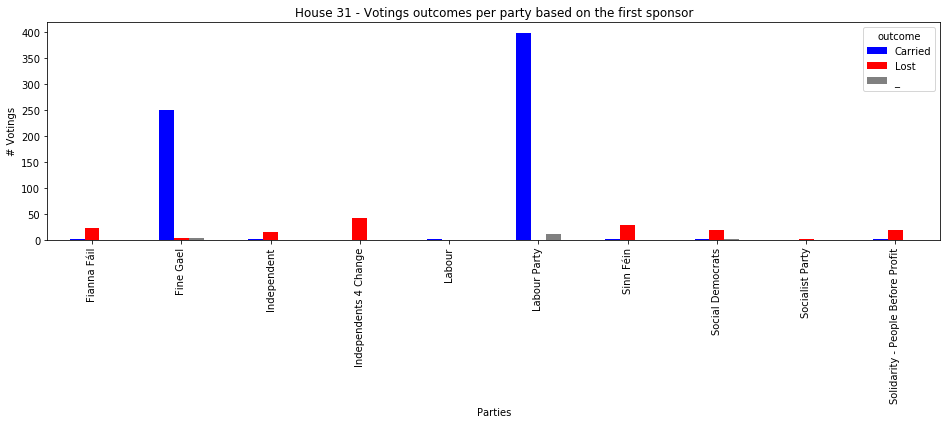

In [187]:
plot_outcome_per_party(dail_outcomes, house='31', colors=['b', 'r', 'grey'])

In [188]:
analyse_house(df_dail_votes, '31', prefix='deputy', id_to_displayname=deputy_id_to_displayname)

Number votings: 104,826
House members: 207
Votes:
Class: 0 Number: 42,899
Class: 1 Number: 61,927
Train on 83860 samples, validate on 20966 samples
Epoch 1/10
83860/83860 [==============================] - 16s 195us/step - loss: 0.1466 - acc: 0.9365 - val_loss: 0.1557 - val_acc: 0.9346
Epoch 2/10
83860/83860 [==============================] - 13s 161us/step - loss: 0.0908 - acc: 0.9638 - val_loss: 0.1284 - val_acc: 0.9416
Epoch 3/10
83860/83860 [==============================] - 14s 163us/step - loss: 0.0846 - acc: 0.9671 - val_loss: 0.1013 - val_acc: 0.9578
Epoch 4/10
83860/83860 [==============================] - 15s 180us/step - loss: 0.0810 - acc: 0.9682 - val_loss: 0.1230 - val_acc: 0.9455
Epoch 5/10
83860/83860 [==============================] - 14s 171us/step - loss: 0.0776 - acc: 0.9700 - val_loss: 0.1063 - val_acc: 0.9523
Epoch 6/10
83860/83860 [==============================] - 14s 163us/step - loss: 0.0748 - acc: 0.9711 - val_loss: 0.1113 - val_acc: 0.9506
Epoch 7/10
83860/8

#### Dail House 32

outcome                            Carried  Lost    _
sponsor                                              
Fianna Fáil                           21.0  13.0  NaN
Fine Gael                            123.0  37.0  1.0
Green Party                            NaN   3.0  NaN
Independent                            NaN  10.0  NaN
Independents 4 Change                  NaN  23.0  NaN
Labour                                 NaN   3.0  NaN
Sinn Féin                              2.0  17.0  NaN
Social Democrats                       NaN   5.0  NaN
Solidarity - People Before Profit      NaN  37.0  1.0


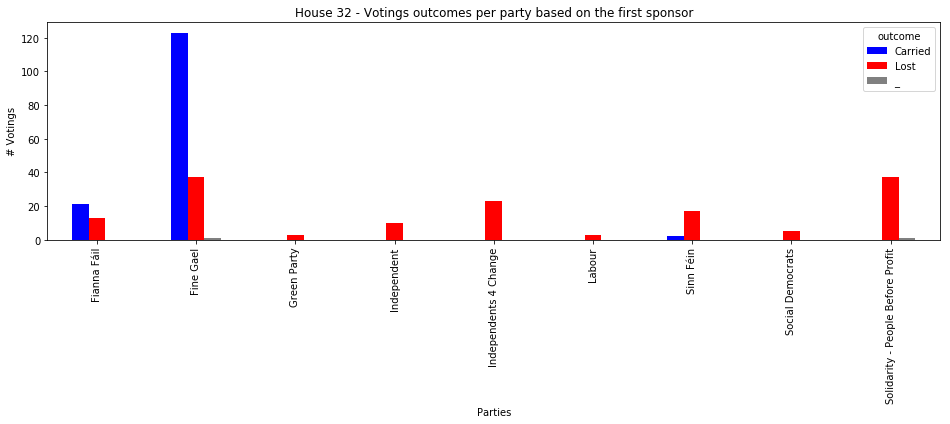

In [189]:
plot_outcome_per_party(dail_outcomes, house='32', colors=['b', 'r', 'grey'])

In [190]:
analyse_house(df_dail_votes, '32', prefix='deputy', id_to_displayname=deputy_id_to_displayname)

Number votings: 42,915
House members: 158
Votes:
Class: 0 Number: 21,068
Class: 1 Number: 19,053
Class: 2 Number: 2,794
Train on 34332 samples, validate on 8583 samples
Epoch 1/10
34332/34332 [==============================] - 15s 450us/step - loss: 0.2055 - acc: 0.6970 - val_loss: 0.4677 - val_acc: 0.8226
Epoch 2/10
34332/34332 [==============================] - 17s 486us/step - loss: -0.2386 - acc: 0.7771 - val_loss: 0.4356 - val_acc: 0.8128
Epoch 3/10
34332/34332 [==============================] - 15s 435us/step - loss: -0.5058 - acc: 0.8179 - val_loss: 0.4228 - val_acc: 0.8252
Epoch 4/10
34332/34332 [==============================] - 13s 370us/step - loss: -0.5930 - acc: 0.8346 - val_loss: 0.3876 - val_acc: 0.8509
Epoch 5/10
34332/34332 [==============================] - 15s 446us/step - loss: -0.6185 - acc: 0.8372 - val_loss: 0.5418 - val_acc: 0.7956
Epoch 6/10
34332/34332 [==============================] - 15s 436us/step - loss: -0.6416 - acc: 0.8398 - val_loss: 0.5233 - val_acc:

### Utils

In [206]:
a = 'á'
print a
ua = u'á'
print ua
print ua.encode('utf8')
print ua.encode('utf8') == '\xc3\xa1'
print ua.encode('latin1')
print ua.encode('latin1') == '\xe1'

á
á
á
True
�
True


In [207]:
a = '�'
print a
ua = u'�'
print ua
print ua.encode('utf8')
print ua.encode('utf8') == u'\ufffd'

�
�
�
False


/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py:6: UnicodeWarning: Unicode equal comparison failed to convert both arguments to Unicode - interpreting them as being unequal
  


In [208]:
print '\xc3\xa1' == str('á')
print str('á').decode('utf-8').encode('utf-8')
print str('á').decode('utf-8').encode('utf-8') == str('\xc3\xa1')
print str('Tá').decode('utf-8').encode('utf-8') == str('T\xc3\xa1')
print str('Níl').decode('utf-8').encode('utf-8') == str('N\xc3\xadl')
print u'á'.encode('utf-8') == '\xc3\xa1'
print u'�', str('\xe1'), u'\ufffd'
print u'�' == u'\ufffd'
print u'T�' == u'T\ufffd'
print u'N�l' == u'N\ufffdl'

True
á
True
True
True
True
� � �
True
True
True


In [209]:
'T\xe1'

'T\xe1'

In [210]:
print 'T\xe1'

T�


In [211]:
'T\xe1'.startswith('T')

True

In [212]:
'Tá'.startswith('T')

True

In [213]:
'Tá'.decode('utf-8').encode('utf-8').startswith('T')

True

In [214]:
'Tá'.decode('utf-8').startswith('T')

True